<a href="https://colab.research.google.com/github/Prarona-Barua/Image-processing/blob/main/object_backgroud_removal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from PIL import Image
import os

In [ ]:
folder_path = '/content/drive/MyDrive/images'

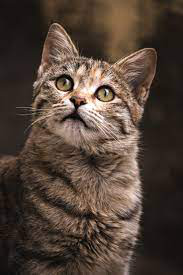

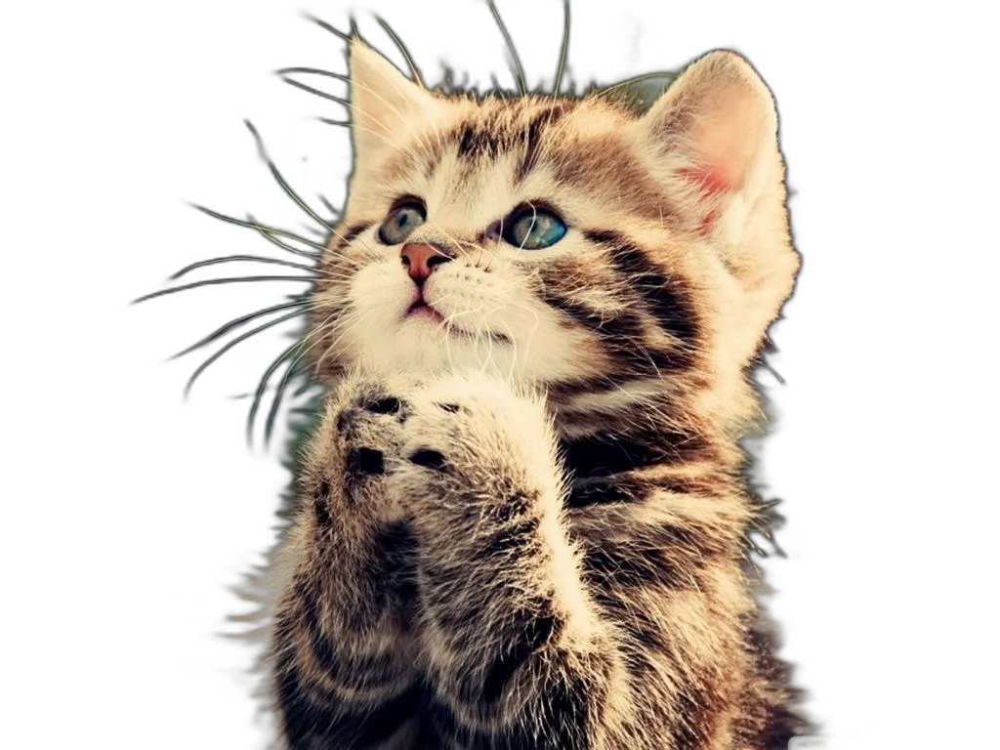

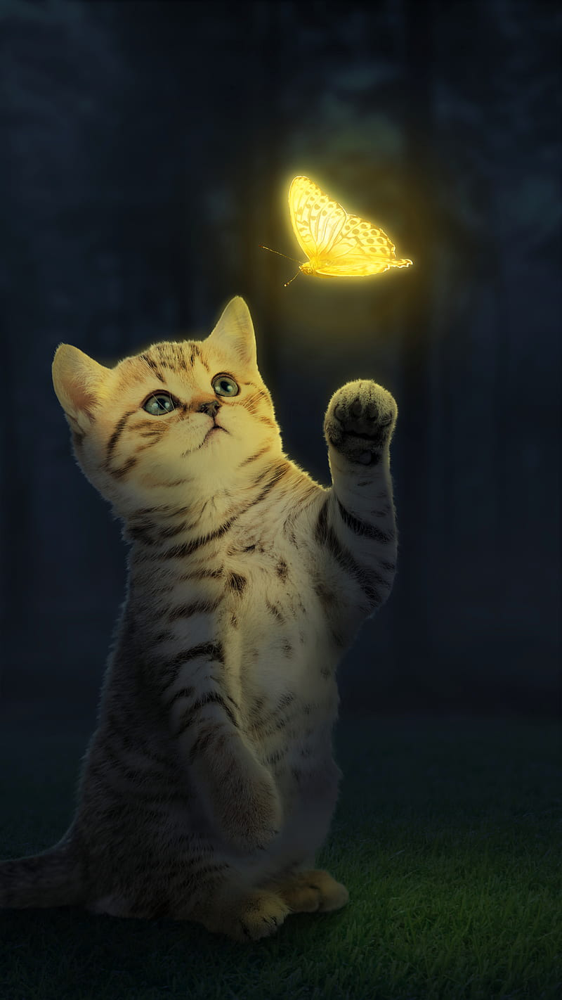

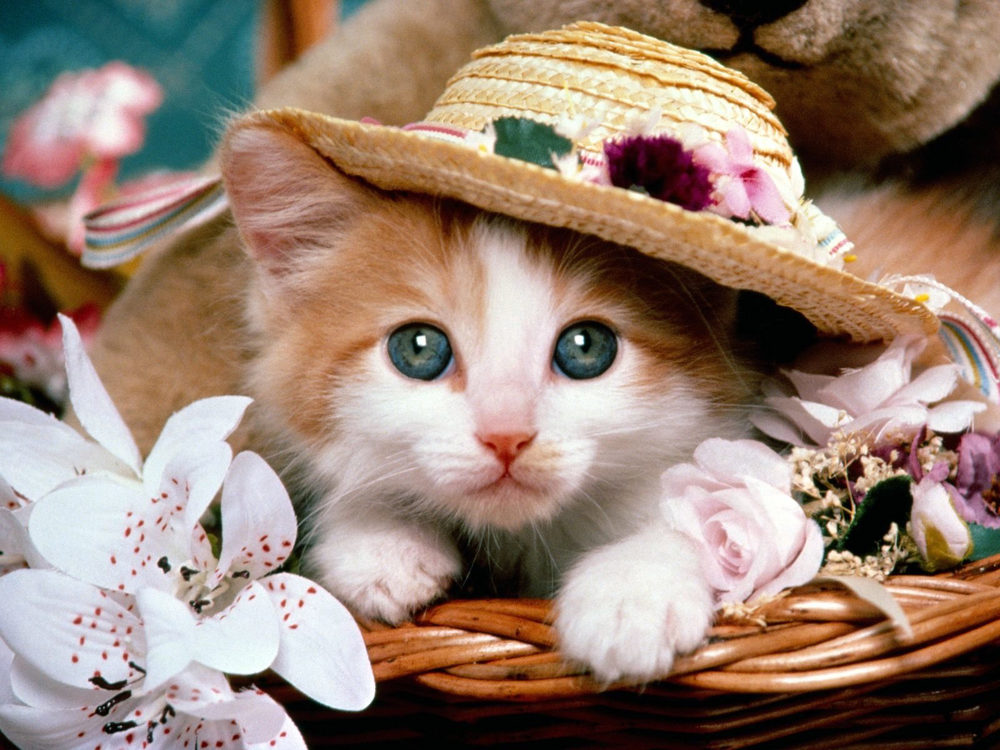

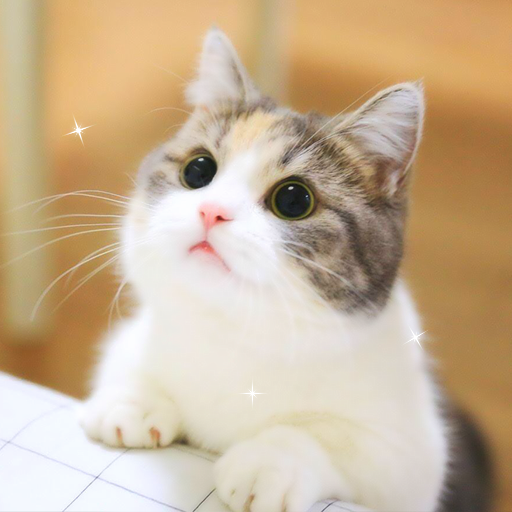

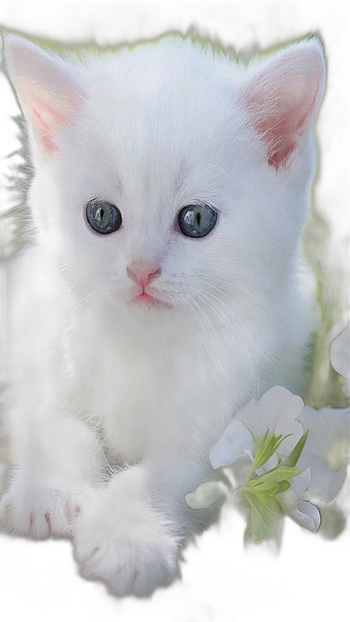

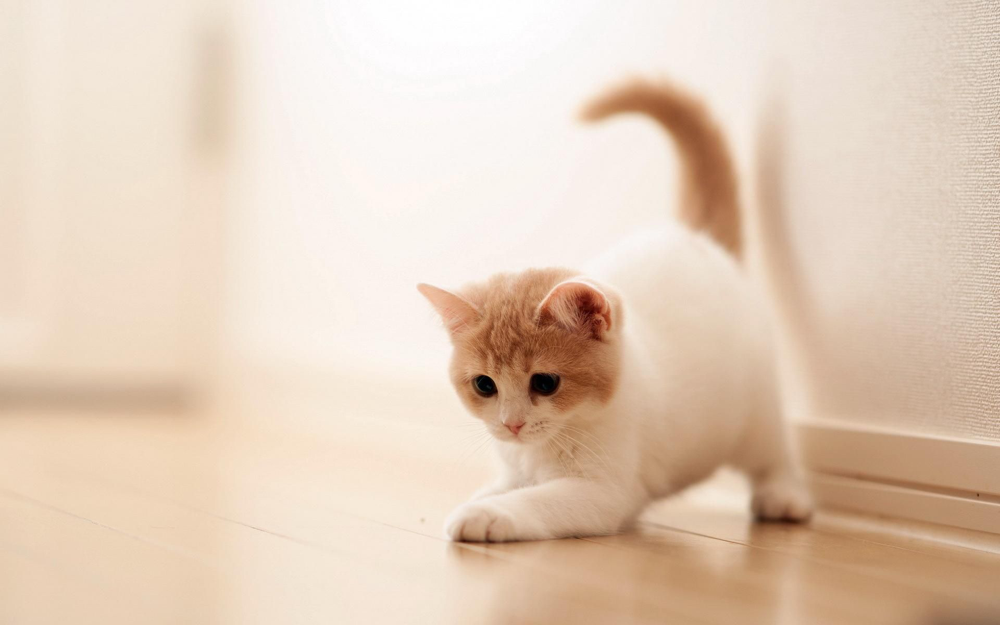

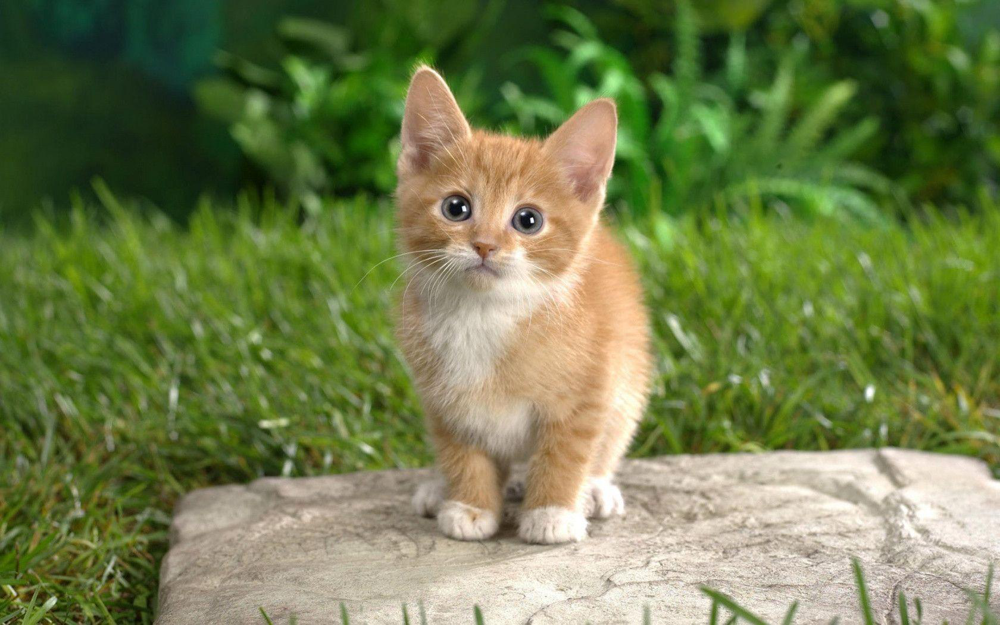

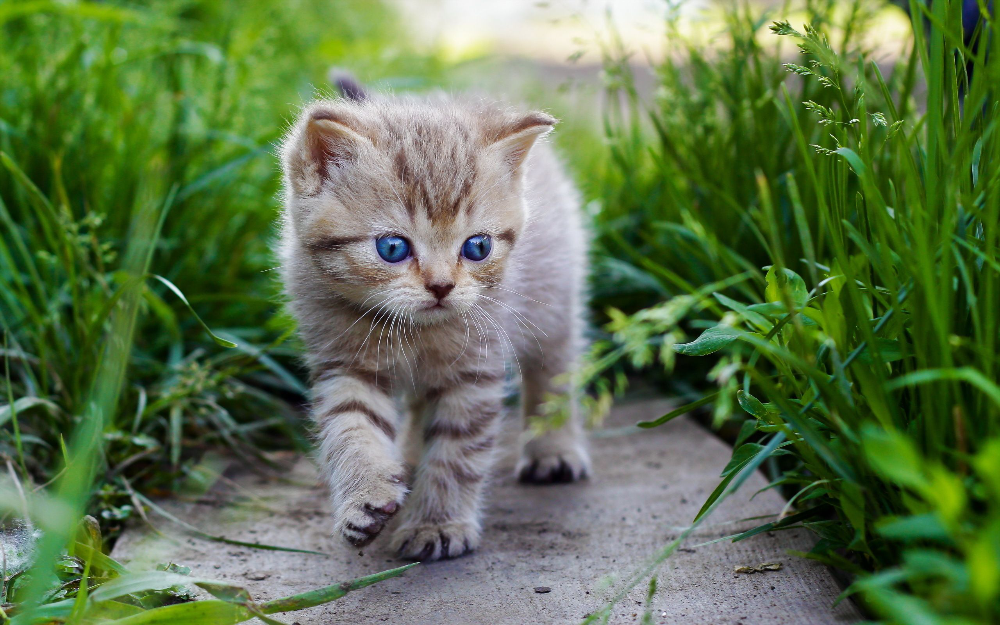

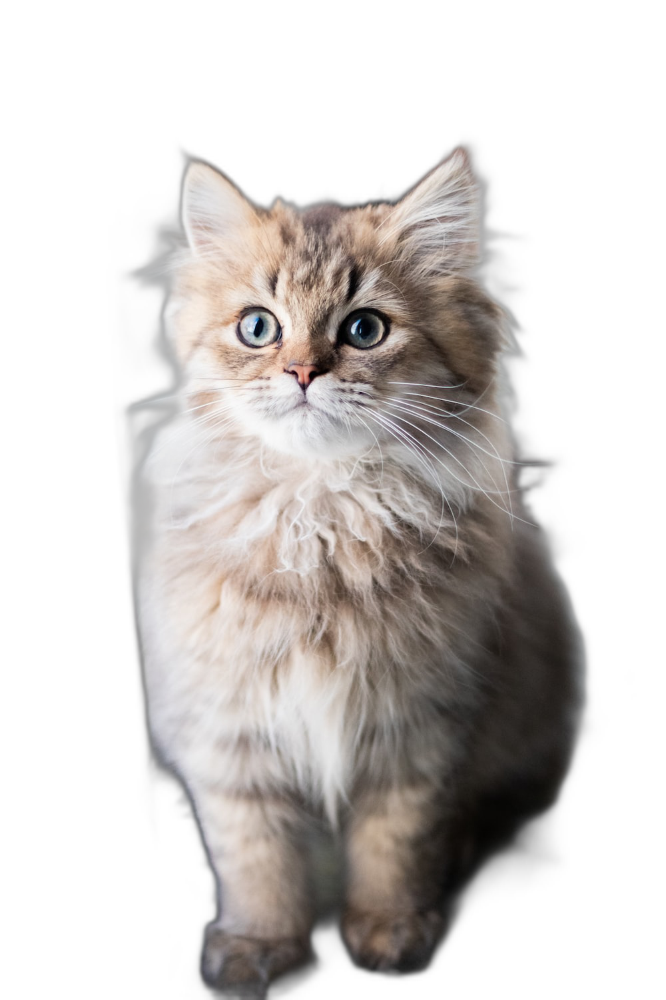

In [ ]:
for filename in os.listdir(folder_path):
    # Check if the file is an image
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # Open the image file
        image_path = os.path.join(folder_path, filename)
        image = Image.open(image_path)

        # Display the image
        image.show()

In [ ]:
!pip install rembg

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from PIL import Image
from rembg import remove

In [ ]:
folder_path = '/content/drive/MyDrive/images'


# Define the output directory path
output_dir = '/content/drive/MyDrive/images'



os.makedirs(output_dir, exist_ok=True)

# Iterate over the files in the folder
for file_name in os.listdir(folder_path):
    # Create the full file path
    file_path = os.path.join(folder_path, file_name)

    # Check if the file is an image
    if file_name.endswith(('.png', '.jpg', '.jpeg')):
        # Open the image
        input_image = Image.open(file_path)

        # Remove the background from the image
        output_image = remove(input_image)

        # Define the output file path with the output directory
        output_file_path = os.path.join(output_dir, 'background_rmv_' + file_name)

        # Save the resulting image with transparent background
        output_image.save(output_file_path, 'PNG')

        print(f"Background removed for: {file_name}")

Background removed for: 2.jpg
Background removed for: 3.jpg
Background removed for: 4.jpg
Background removed for: 5.jpg
Background removed for: 6.jpg
Background removed for: 7.jpg
Background removed for: 8.jpg
Background removed for: 9.jpg
Background removed for: 10.jpg
Background removed for: 1.jpg


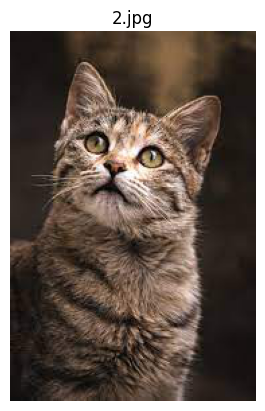

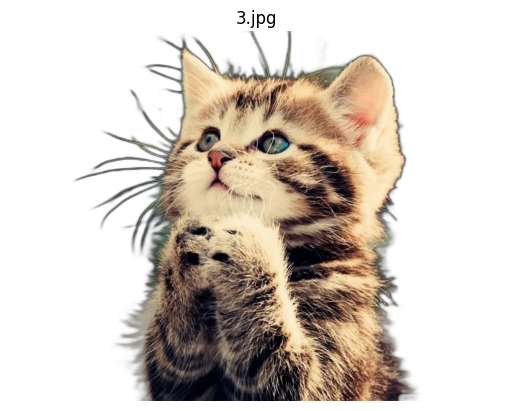

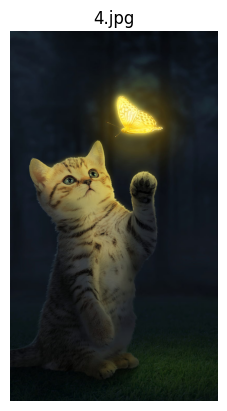

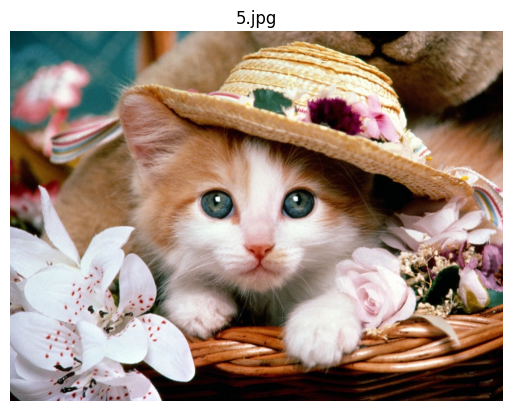

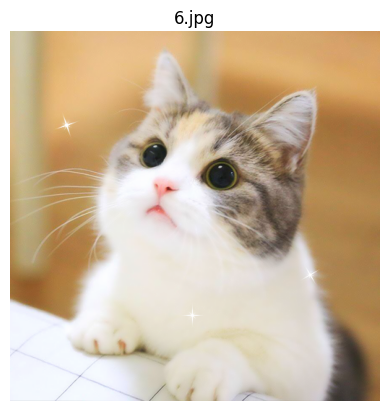

...

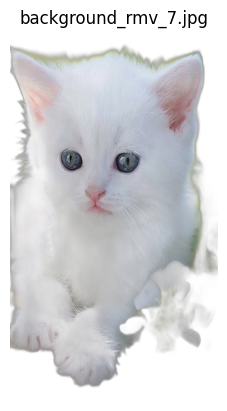

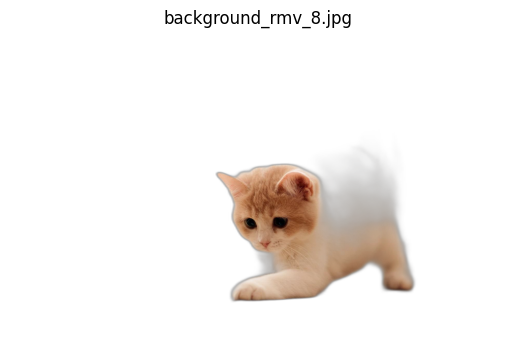

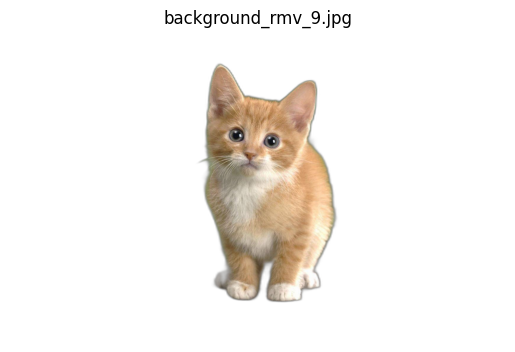

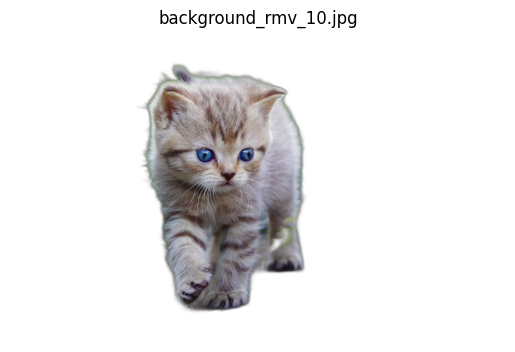

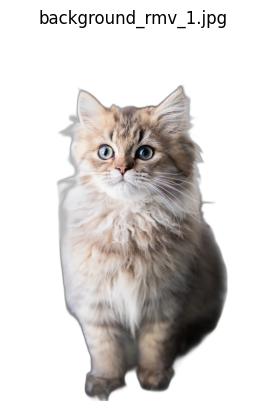

In [ ]:
for filename in os.listdir(output_dir):
    # Check if the file is an image
    if filename.endswith('.png') or filename.endswith('.jpg'):
        # Open the image
        image_path = os.path.join(output_dir, filename)
        image = Image.open(image_path)

        # Display the image
        plt.imshow(image)
        plt.title(filename)
        plt.axis('off')
        plt.show()

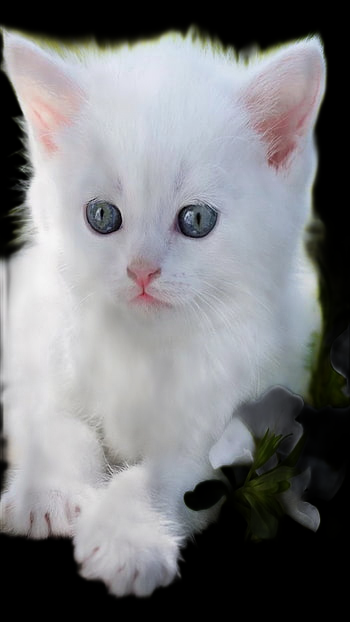

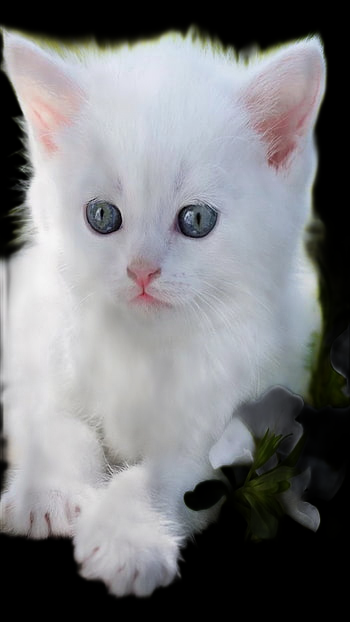

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
from PIL import Image


# Store path of the input image
input_path = '/content/drive/MyDrive/images/7.jpg'
# Store path of the output image
output_path = '/content/drive/MyDrive/images/7.jpg'

# Open the input image
input_image = Image.open(input_path)

# Remove the background from the input image
output_image = remove(input_image)

# Saving the output image with transparent background
output_image.save(output_path, 'PNG')

# Read the input and output images using OpenCV
input_image_cv = cv2.imread(input_path)
output_image_cv = cv2.imread(output_path)

# Display the input image using cv2_imshow()
cv2_imshow(input_image_cv)

# Display the output image using cv2_imshow()
cv2_imshow(output_image_cv)

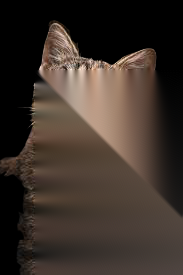

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

# Read the image
image = cv2.imread('/content/drive/MyDrive/images/2.jpg')

# Create a mask initialized with zeros
mask = np.zeros(image.shape[:2], np.uint8)

# Define the region of interest (ROI) containing the object to be removed
roi = (35, 70, 300, 400)  # Example: (x, y, width, height)

# Set the pixels inside the ROI to be white (255)
mask[roi[1]:roi[1]+roi[3], roi[0]:roi[0]+roi[2]] = 255

# Apply the inpainting algorithm to remove the object
result = cv2.inpaint(image, mask, 3, cv2.INPAINT_TELEA)

# Display the result using cv2_imshow()
cv2_imshow(result)

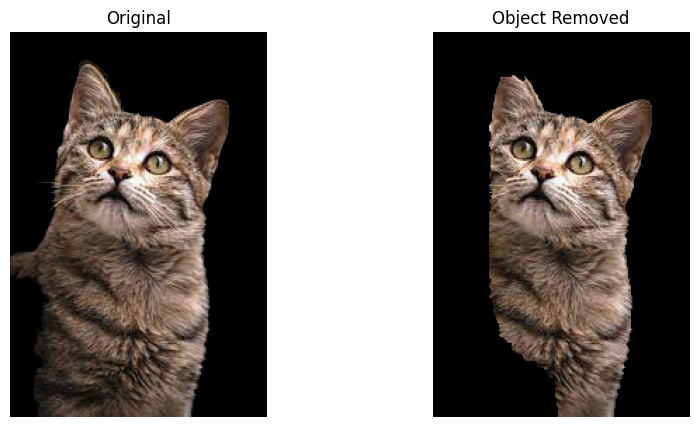

In [ ]:
input_path = '/content/drive/MyDrive/images/2.jpg'


def remove_object(image, mask):
    # Create a mask with the area to be removed
    mask = np.where((mask == 2) | (mask == 0), 0, 1).astype('uint8')

    # Apply the mask to the image
    result = image * mask[:, :, np.newaxis]

    return result

# Read the image
image = cv2.imread(input_path)

# Convert image to RGB color (OpenCV reads images in BGR format)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Create a mask initialized with zeros
mask = np.zeros(image.shape[:2], np.uint8)

# Define the region of interest (ROI) containing the object to be removed
roi = (40, 30, 400, 400)  # Example: (x, y, width, height)

# Set the background and foreground models for GrabCut
bgd_model = np.zeros((1, 65), np.float64)
fgd_model = np.zeros((1, 65), np.float64)

# Apply GrabCut algorithm to segment the object from the image
cv2.grabCut(image, mask, roi, bgd_model, fgd_model, 5, cv2.GC_INIT_WITH_RECT)

# Remove the object from the image
result = remove_object(image_rgb, mask)

# Display the images
fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(image_rgb)
axes[0].set_title('Original')
axes[0].axis('off')
axes[1].imshow(result)
axes[1].set_title('Object Removed')
axes[1].axis('off')
plt.show()